## Prepare and extract dataset

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import zipfile
import os

toptal_drive_dir = "/content/drive/My Drive/Toptal"
dataset_zip_path = os.path.join(toptal_drive_dir, "statues-train-v2.zip")

# Unzipping the dataset
with zipfile.ZipFile(dataset_zip_path, 'r') as zip_ref:
    zip_ref.extractall("/content/dataset")

# Dataset exploration

In [3]:
import os
import cv2
import matplotlib.pyplot as plt
import pandas as pd
from PIL import Image
import matplotlib.patches as patches
import numpy as np

In [4]:
# Base directory
base_dir = "/content/dataset/statues-train"

# Directories for each class
class_directories = {
    'lenin': os.path.join(base_dir, 'statues-lenin'),
    'ataturk': os.path.join(base_dir, 'statues-ataturk'),
    'other': os.path.join(base_dir, 'statues-other')
}

## Images

First look at the images

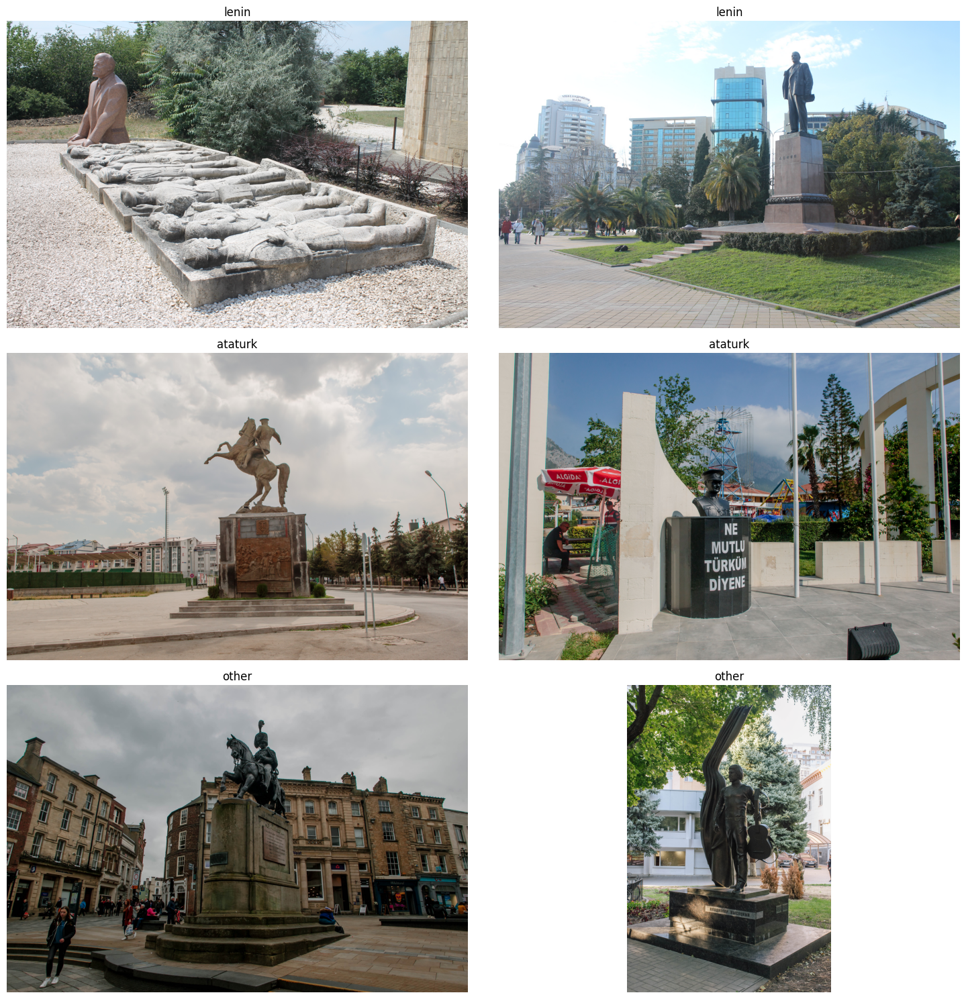

In [5]:
# Function to display images with clabels
def display_images_with_labels(image_paths, labels, rows, cols):
    fig, axes = plt.subplots(rows, cols, figsize=(15, 5*rows))
    axes = axes.flatten()
    for img_path, label, ax in zip(image_paths, labels, axes):
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        ax.imshow(img)
        ax.set_title(label)
        ax.axis('off')
    plt.tight_layout()
    plt.show()


# Collect a list of image paths and their class labels
image_paths = []
class_labels = []
num_images_per_class = 2

for label, directory in class_directories.items():
    image_files = os.listdir(directory)[:num_images_per_class]
    image_paths.extend([os.path.join(directory, file) for file in image_files])
    class_labels.extend([label for _ in image_files])


# Display images with labels (only one)
rows = len(class_directories)  # Number of different classes
cols = num_images_per_class  # Number of images per class
display_images_with_labels(image_paths, class_labels, rows, cols)

File extensions check

In [6]:
def print_unique_file_extensions(class_directories):
    file_extensions = set()
    for class_name, directory in class_directories.items():
        # List all files in the directory
        for filename in os.listdir(directory):
            # Get the file extension
            file_ext = os.path.splitext(filename)[1]
            file_extensions.add(file_ext)

    print("Unique file extensions found in class directories:")
    for ext in file_extensions:
        print(ext)


print_unique_file_extensions(class_directories)

Unique file extensions found in class directories:
.JPG
.jpg


Image sizes investigation

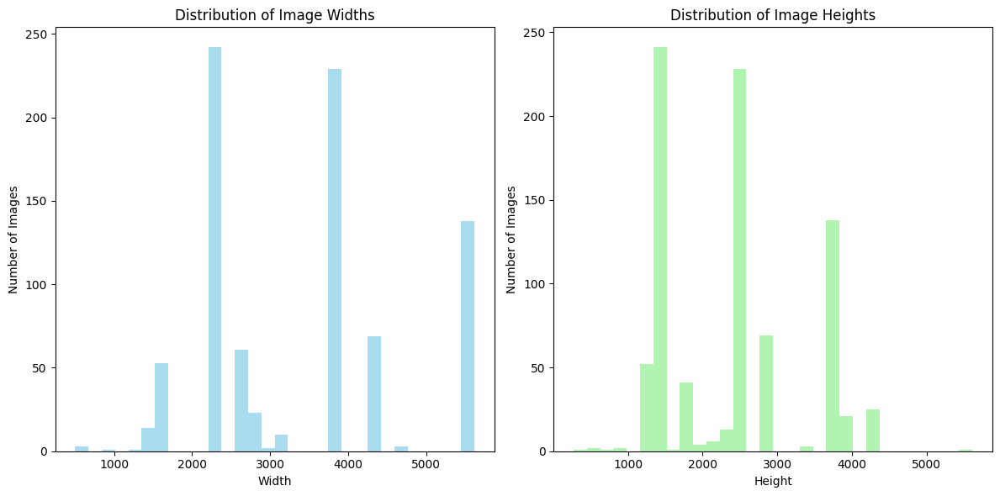

Widths - min: 501, max: 5616, mean: 3400.56, median: 3861
Heights - min: 271, max: 5616, mean: 2423.44, median: 2574


In [7]:
import os
from PIL import Image
import matplotlib.pyplot as plt

def analyze_image_sizes(class_directories):
    widths, heights = [], []
    for class_name, directory in class_directories.items():
        for filename in os.listdir(directory):
            filepath = os.path.join(directory, filename)
            with Image.open(filepath) as img:
                width, height = img.size
                widths.append(width)
                heights.append(height)

    # Plotting the distribution of widths and heights
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(widths, bins=30, color='skyblue', alpha=0.7)
    plt.title('Distribution of Image Widths')
    plt.xlabel('Width')
    plt.ylabel('Number of Images')

    plt.subplot(1, 2, 2)
    plt.hist(heights, bins=30, color='lightgreen', alpha=0.7)
    plt.title('Distribution of Image Heights')
    plt.xlabel('Height')
    plt.ylabel('Number of Images')

    plt.tight_layout()
    plt.show()

    # Print statistics
    print(f"Widths - min: {min(widths)}, max: {max(widths)}, mean: {sum(widths)/len(widths):.2f}, median: {sorted(widths)[len(widths)//2]}")
    print(f"Heights - min: {min(heights)}, max: {max(heights)}, mean: {sum(heights)/len(heights):.2f}, median: {sorted(heights)[len(heights)//2]}")

analyze_image_sizes(class_directories)


## Labels

### Load CSVs

In [8]:
# Read CSV and display first rows
labels_path = os.path.join(base_dir, 'statues_labels.csv')
labels_df = pd.read_csv(labels_path)

print(labels_df.head())

              filename  width  height  class  xmin  ymin  xmax  ymax
0  Balashikha_0204.JPG   1296     864  lenin   683   198   709   230
1   New_Mexico_947.jpg   1404     936  other   619   205   648   234
2       Skopje_037.JPG   1128     752  other   457    34   509    97
3       Skopje_037.JPG   1128     752  other   414   267   480   346
4       Skopje_037.JPG   1128     752  other   715   287   789   349


In [9]:
# Read second CSV and display first rows
labels_path2 = os.path.join(base_dir, 'statues_labels2.csv')
labels_df2 = pd.read_csv(labels_path2)

print(labels_df2.head())

   Acipayam_043.jpg;2814;1065;2955;1233;ataturk
0    Acipayam_044.jpg;2851;738;3015;948;ataturk
1  Acipayam_047.jpg;2189;1513;2465;1805;ataturk
2   Acipayam_048.jpg;2066;816;2318;1168;ataturk
3  Acipayam_050.jpg;4153;1532;4240;1634;ataturk
4  Acipayam_053.jpg;2541;1557;2705;1693;ataturk


In [10]:
# Read the CSV file while specifying the separator and assigning the column names
column_names = ['filename', 'xmin', 'ymin', 'xmax', 'ymax', 'class']
labels_df2 = pd.read_csv(labels_path2, sep=';', names=column_names)

print(labels_df2.head())

           filename  xmin  ymin  xmax  ymax    class
0  Acipayam_043.jpg  2814  1065  2955  1233  ataturk
1  Acipayam_044.jpg  2851   738  3015   948  ataturk
2  Acipayam_047.jpg  2189  1513  2465  1805  ataturk
3  Acipayam_048.jpg  2066   816  2318  1168  ataturk
4  Acipayam_050.jpg  4153  1532  4240  1634  ataturk


### Visualize labels

In [11]:
# Function to add a bounding box to an image
def add_bounding_box_to_image(image_path, bbox):
    image = Image.open(image_path)
    plt.figure(figsize=(12, 8))
    ax = plt.gca()
    ax.imshow(image)
    x, y, xmax, ymax = bbox
    rect = patches.Rectangle((x, y), xmax-x, ymax-y, linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)
    plt.title(f"Image Path: {image_path}")
    plt.axis('off')
    plt.show()

# Function to display images with a bounding box (only one)
def display_images_with_boxes(labels_df, n_samples):
    sample = labels_df.sample(n_samples)
    for index, row in sample.iterrows():
        class_directory = class_directories.get(row['class'], 'other')
        image_path = os.path.join(class_directory, row['filename'])
        bbox = [row['xmin'], row['ymin'], row['xmax'], row['ymax']]
        add_bounding_box_to_image(image_path, bbox)

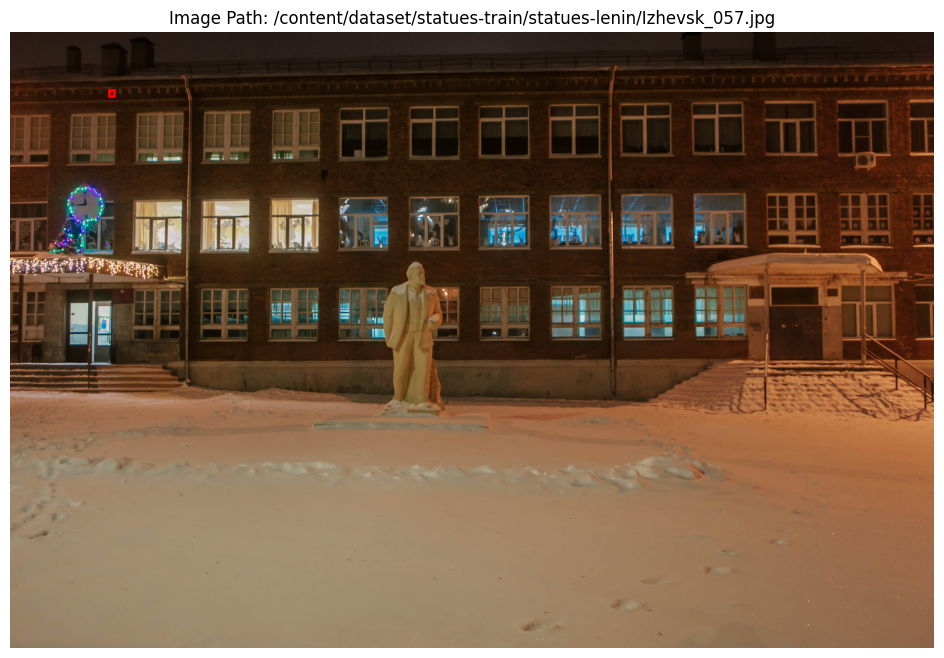

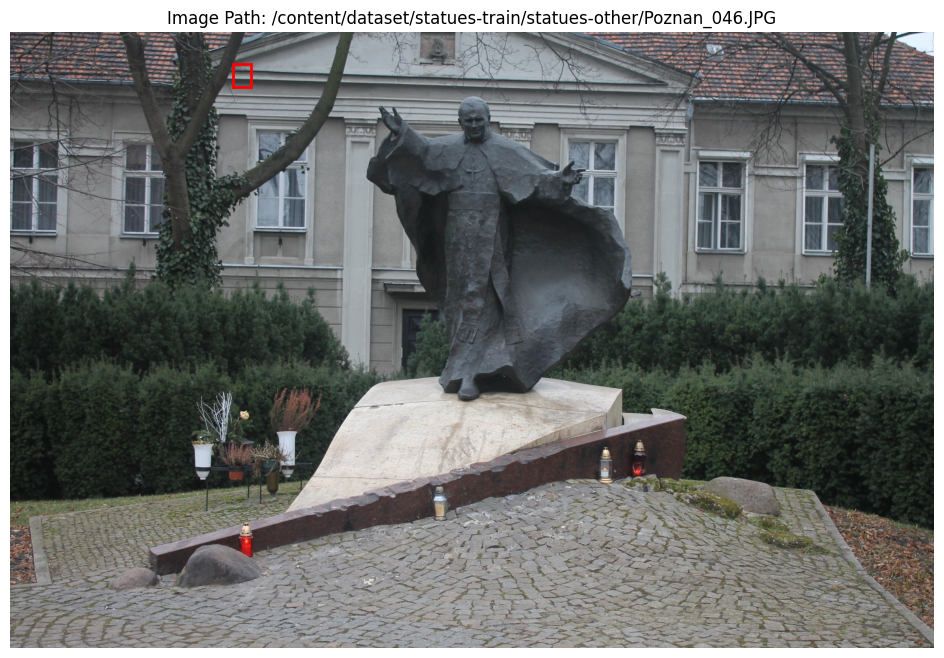

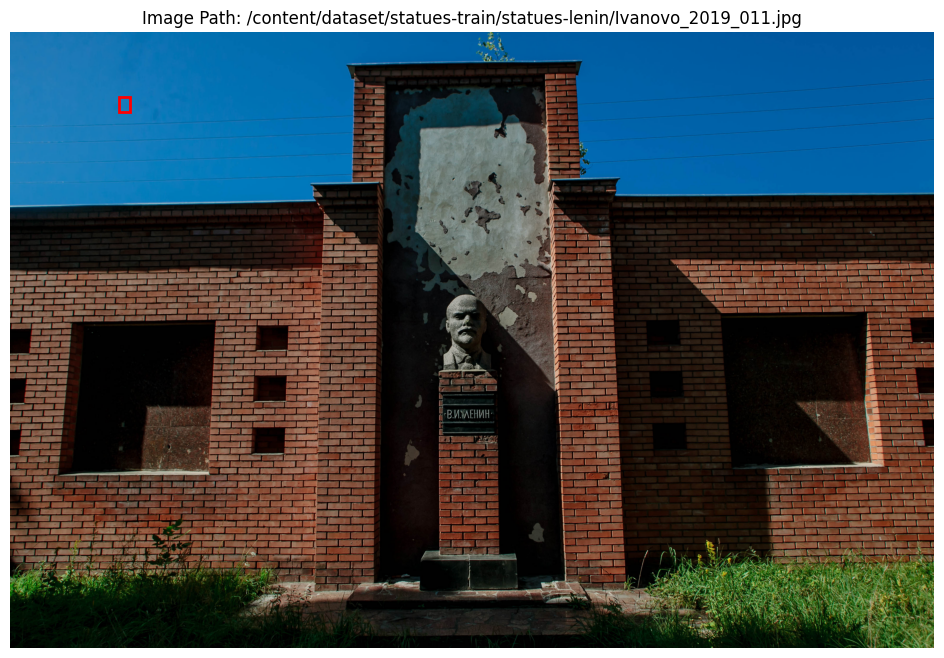

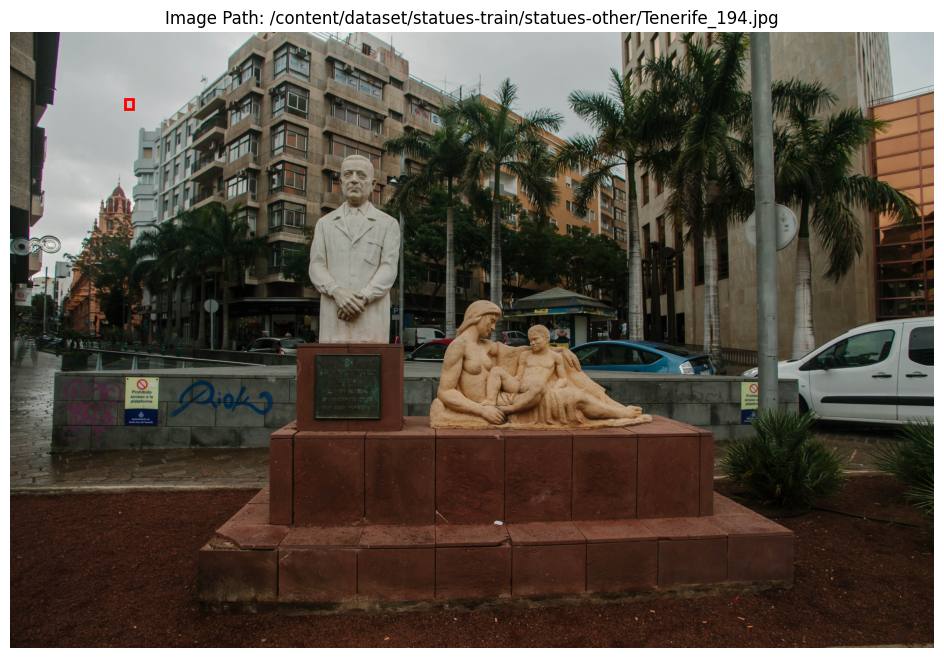

In [12]:
# Display bounding boxes for a sample from the first CSV
display_images_with_boxes(labels_df, 4)

Coordinates of the first CSV are off. Also rotation seems off for some images. Let's try to fix that.

In [13]:
labels_df_fixed = labels_df.copy()
labels_df_fixed['rotated'] = False


def scale_bounding_boxes(row, img, rotated):
    # If the image is rotated, swap width and height for scaling calculation
    img_width = img.height if rotated else img.width
    img_height = img.width if rotated else img.height

    # Calculate scale factors
    x_scale = img_width / row['width']
    y_scale = img_height / row['height']

    # Scale the bounding box coordinates and return them
    scaled_xmin = round(row['xmin'] * x_scale)
    scaled_xmax = round(row['xmax'] * x_scale)
    scaled_ymin = round(row['ymin'] * y_scale)
    scaled_ymax = round(row['ymax'] * y_scale)

    return scaled_xmin, scaled_ymin, scaled_xmax, scaled_ymax


def find_image_path(row, class_directories):
    primary_directory = class_directories.get(row['class'], 'other')
    primary_path = os.path.join(primary_directory, row['filename'])
    if os.path.exists(primary_path):
        return primary_path
    else:
        # Check other directories
        for class_name, directory in class_directories.items():
            if class_name != row['class']:
                alternative_path = os.path.join(directory, row['filename'])
                if os.path.exists(alternative_path):
                    return alternative_path
    return None


# Apply the scaling to each row in the dataframe
for index, row in labels_df_fixed.iterrows():
    image_path = find_image_path(row, class_directories)
    try:
        with Image.open(image_path) as img:
            # Check if the image is rotated by comparing aspect ratios
            rotated = (row['width'] > row['height']) != (img.width > img.height)
            labels_df_fixed.loc[index, 'rotated'] = rotated

            # Get the scaled bounding box coordinates
            scaled_xmin, scaled_ymin, scaled_xmax, scaled_ymax = scale_bounding_boxes(row, img, rotated)

            # Update the values
            labels_df_fixed.loc[index, 'xmin'] = scaled_xmin
            labels_df_fixed.loc[index, 'ymin'] = scaled_ymin
            labels_df_fixed.loc[index, 'xmax'] = scaled_xmax
            labels_df_fixed.loc[index, 'ymax'] = scaled_ymax

    except FileNotFoundError:
        print(f"{row['filename']} not found.")


# Check the updated dataframe
print(labels_df_fixed.head())

              filename  width  height  class  xmin  ymin  xmax  ymax  rotated
0  Balashikha_0204.JPG   1296     864  lenin  1366   396  1418   460    False
1   New_Mexico_947.jpg   1404     936  other  2476   820  2592   936    False
2       Skopje_037.JPG   1128     752  other   914    68  1018   194    False
3       Skopje_037.JPG   1128     752  other   828   534   960   692    False
4       Skopje_037.JPG   1128     752  other  1430   574  1578   698    False


All image files could be loaded. No image corrupted neither missing images.

In [14]:
# Function to add a bounding box to an image and rotate if necessary
def add_bounding_box_to_image_rotate(image_path, bbox, rotate=False):
    # Load image using PIL
    image = Image.open(image_path)

    # Rotate the image if needed
    if rotate:
        image = image.rotate(-90, expand=True)

    # Plotting
    plt.figure(figsize=(12, 8))
    ax = plt.gca()
    ax.imshow(image)
    x, y, xmax, ymax = bbox
    rect = patches.Rectangle((x, y), xmax-x, ymax-y, linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)

    plt.title(f"Image Path: {image_path}")
    plt.axis('off')
    plt.show()


# Function to display images with bounding boxes
def display_images_with_boxes(labels_df, n_samples):
    samples = labels_df.sample(n_samples)
    for index, row in samples.iterrows():
        image_path = find_image_path(row, class_directories)
        bbox = [row['xmin'], row['ymin'], row['xmax'], row['ymax']]
        add_bounding_box_to_image_rotate(image_path, bbox, row['rotated'])

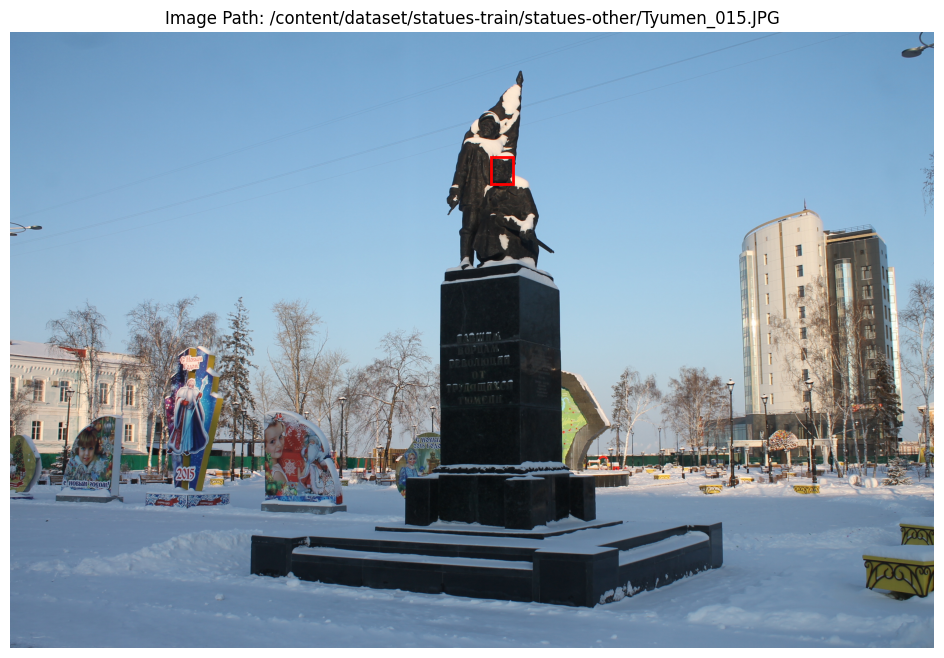

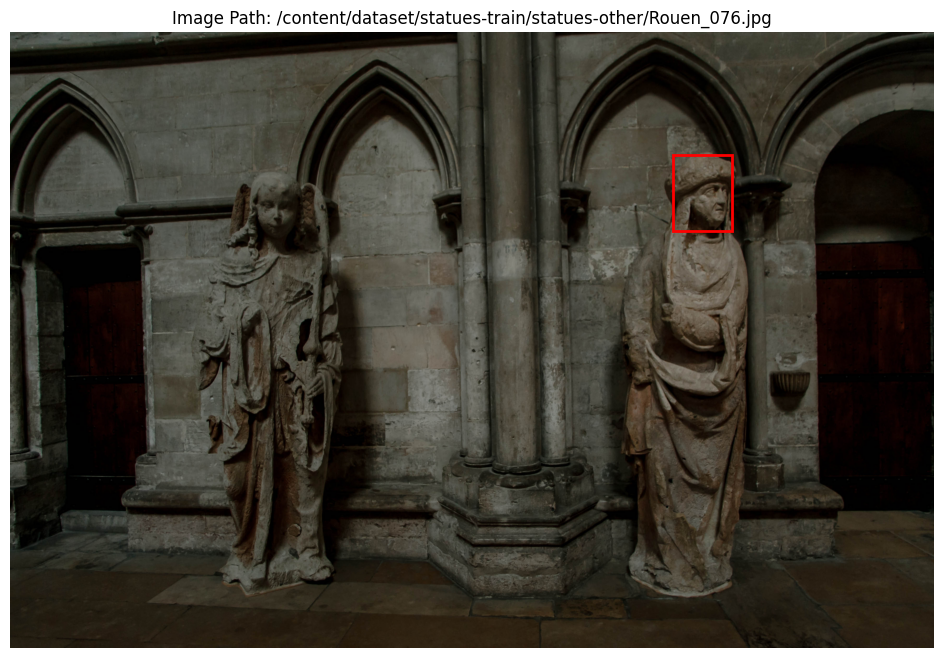

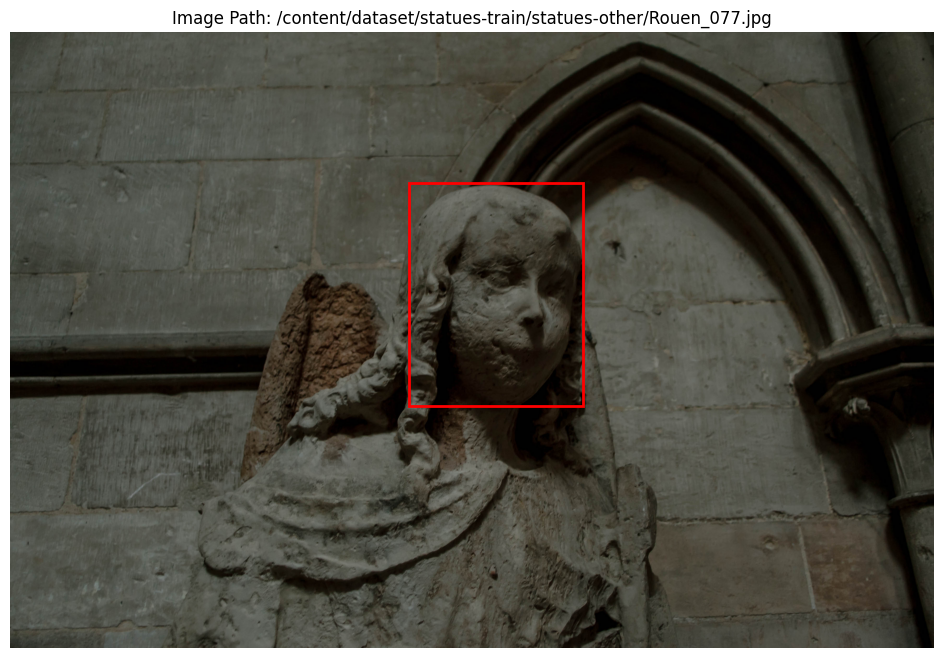

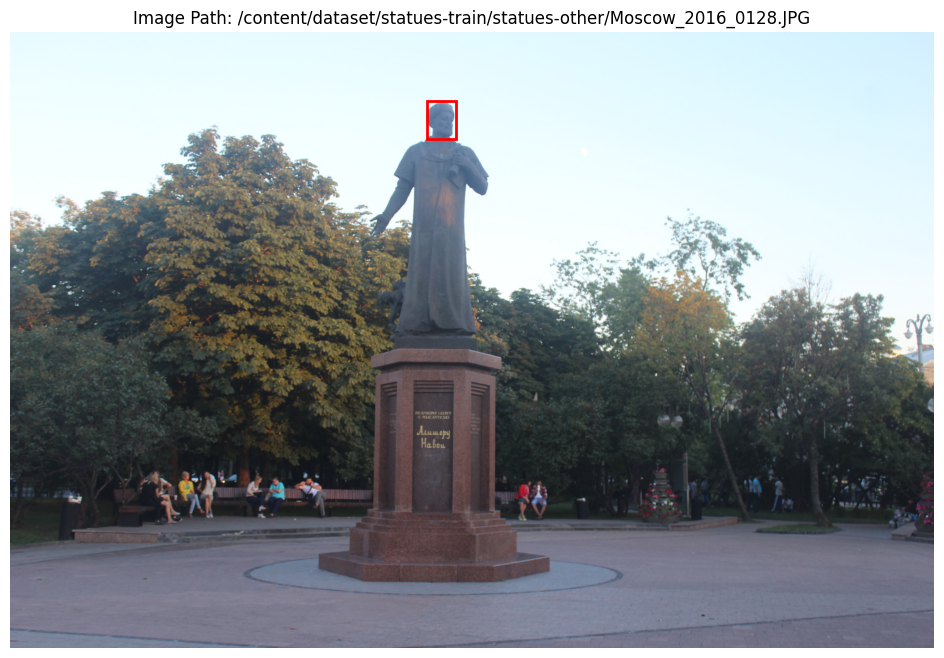

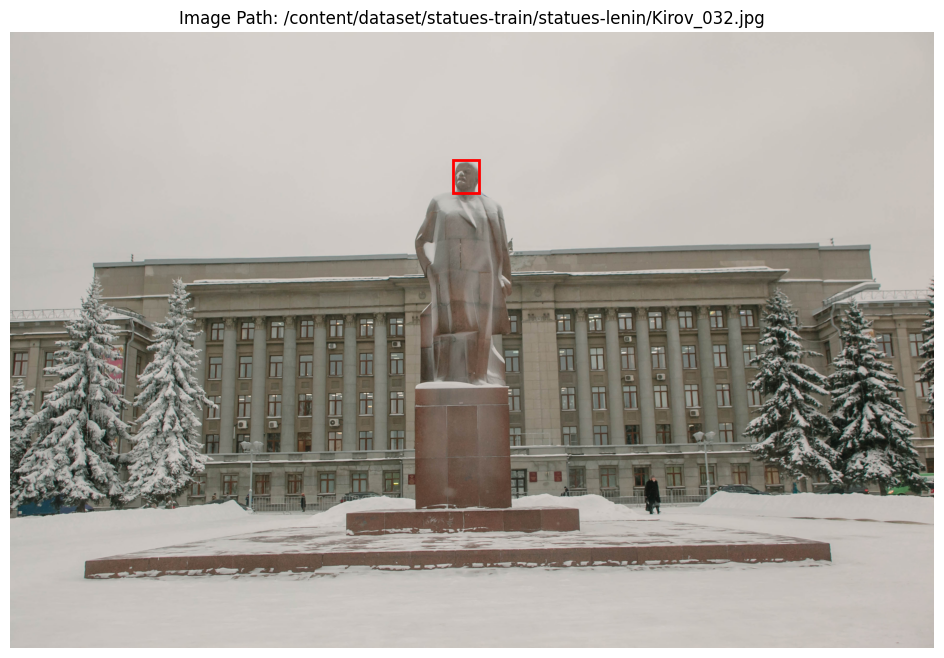

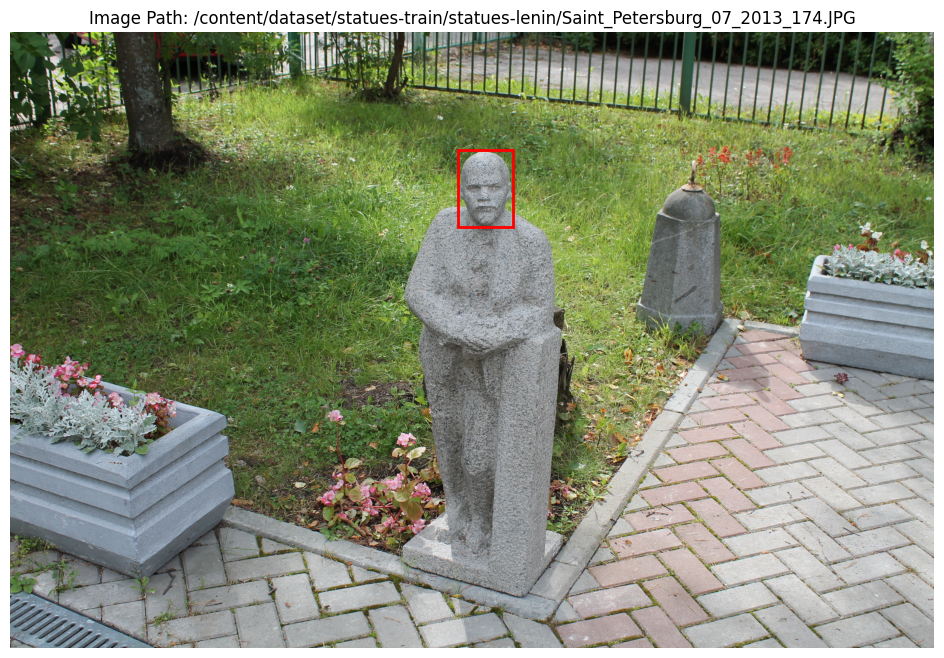

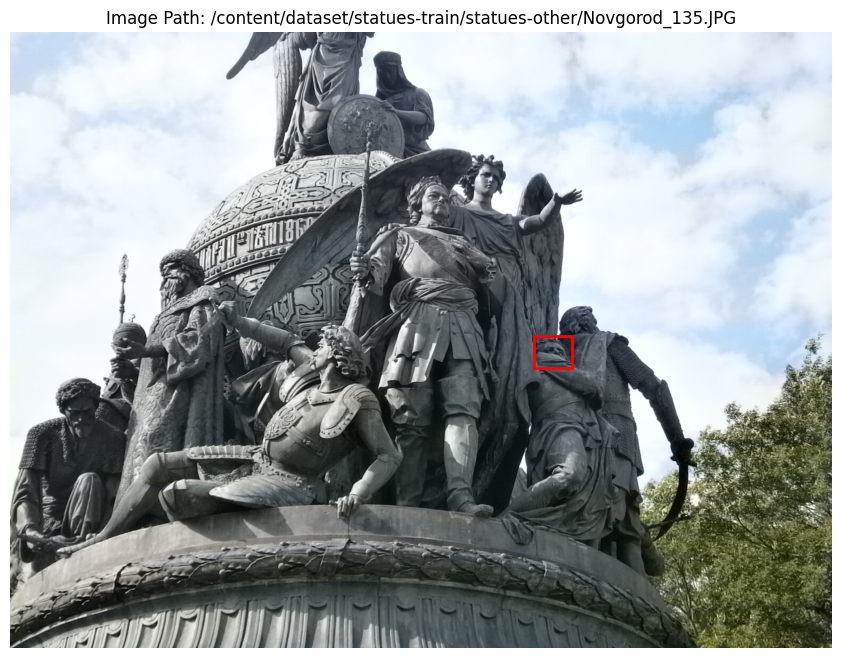

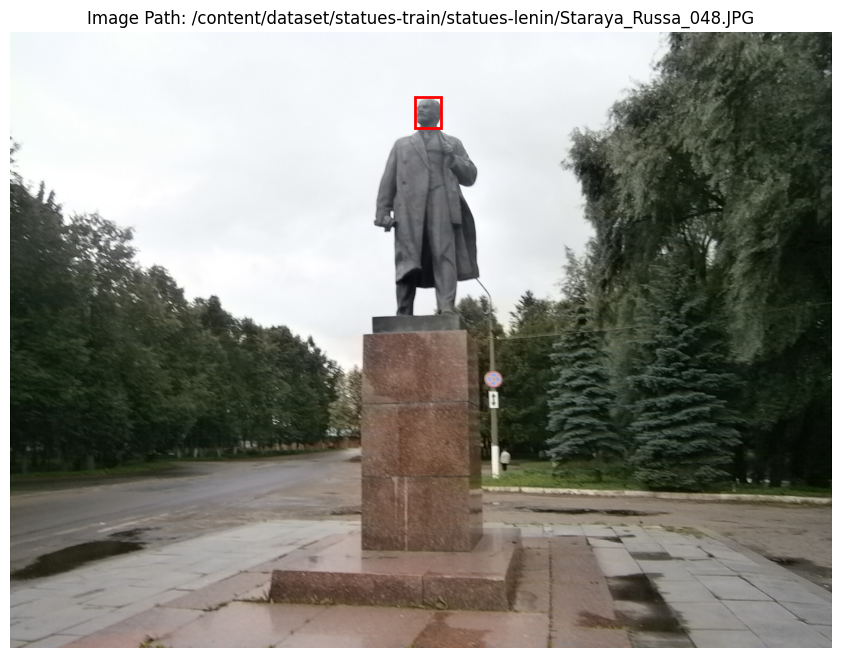

In [15]:
# Display bounding boxes for a sample from the first CSV
display_images_with_boxes(labels_df_fixed, 8)

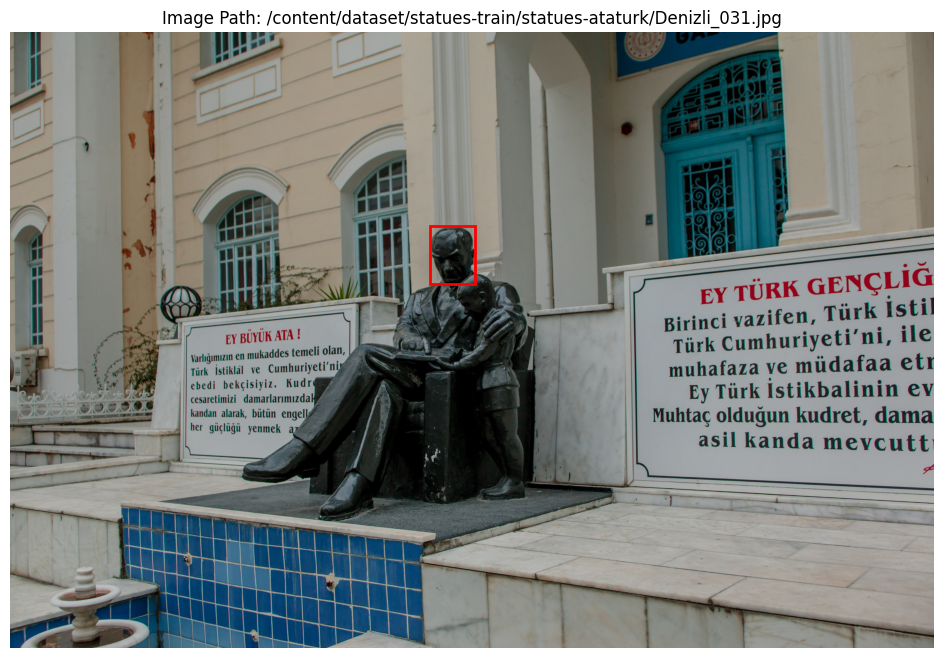

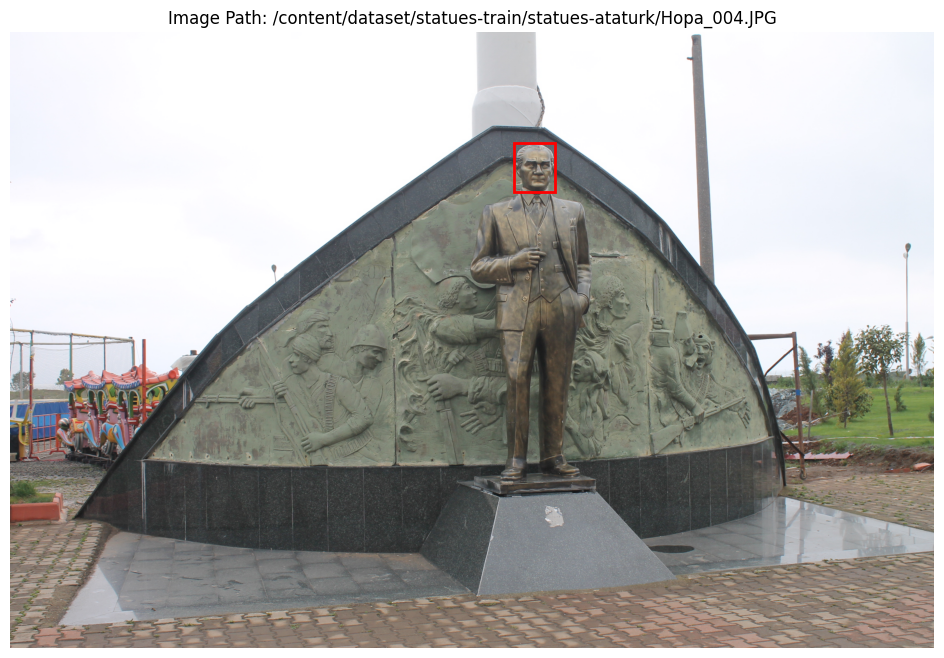

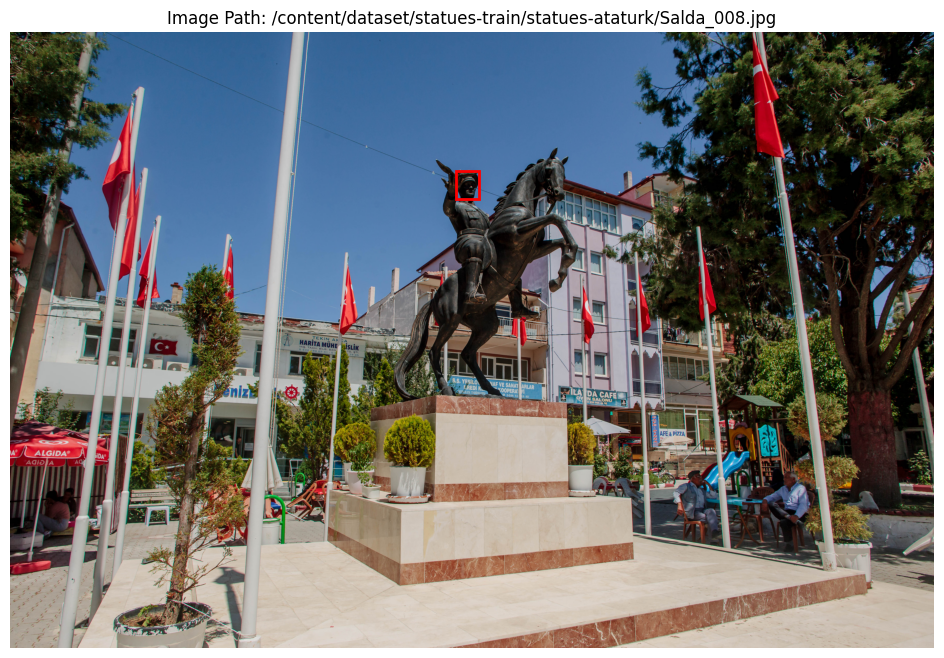

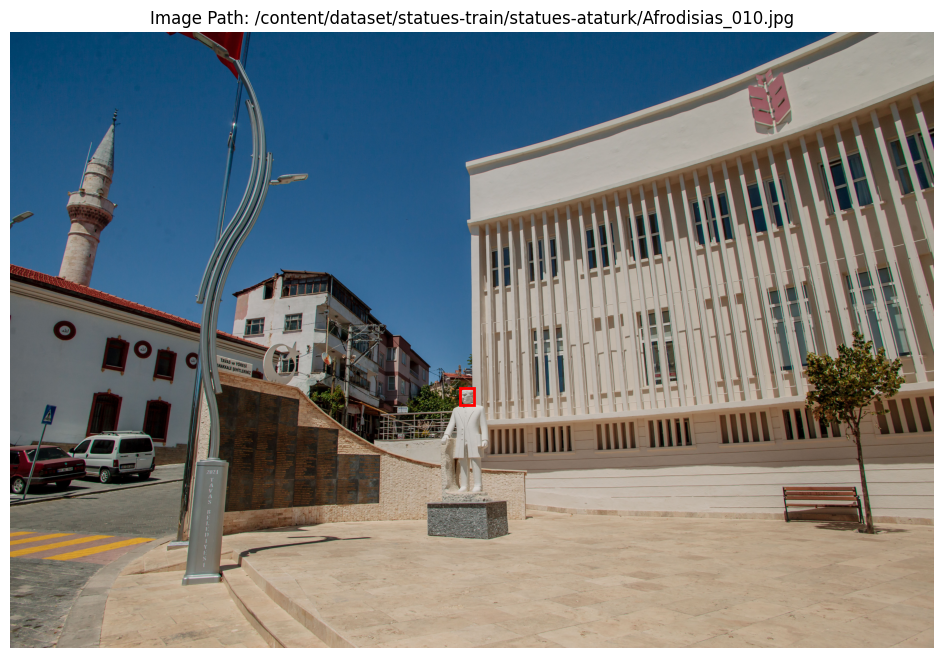

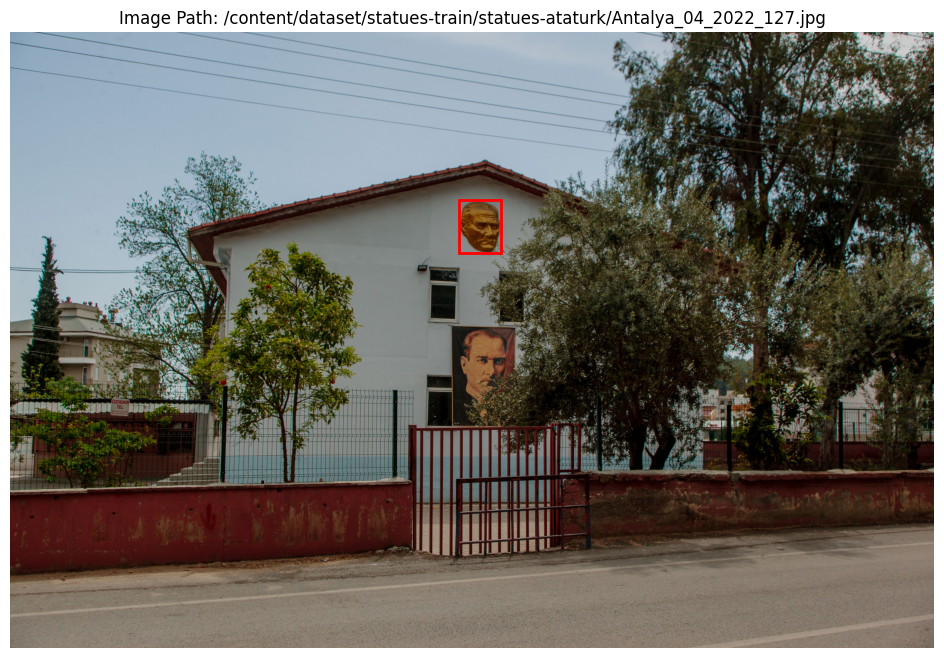

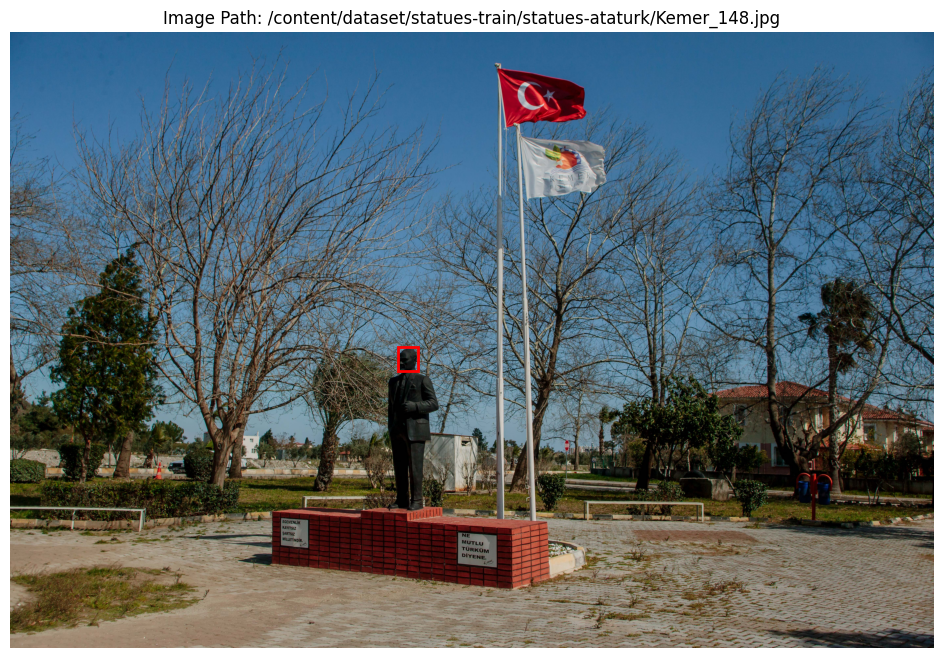

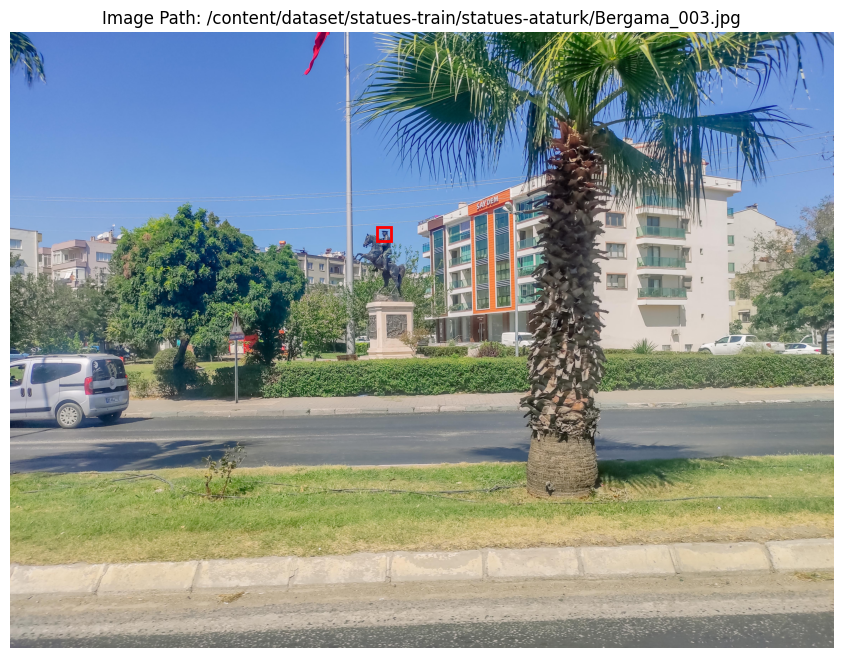

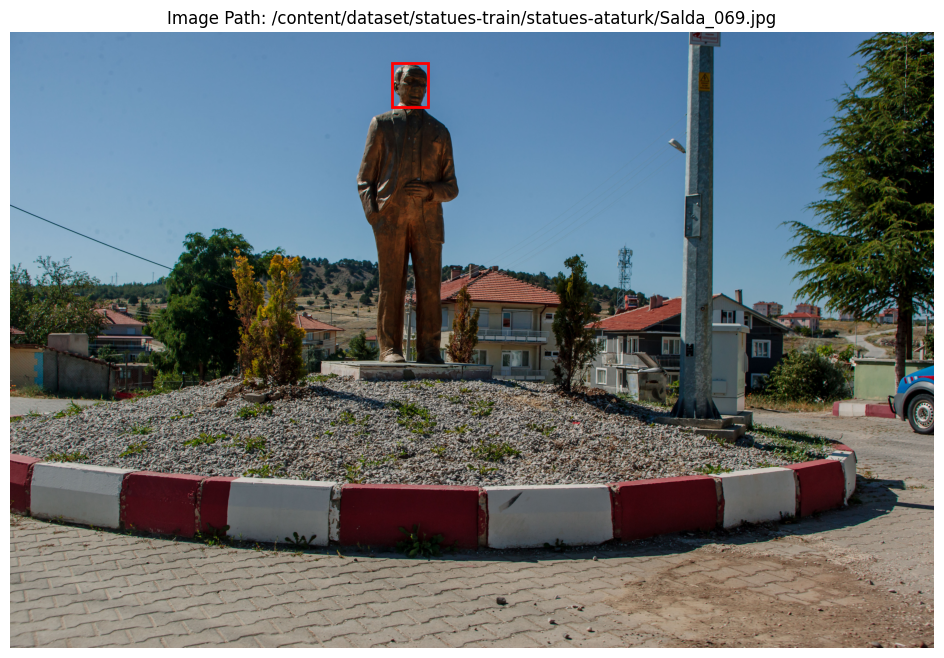

In [16]:
# Display bounding boxes for a sample from the second CSV
labels_df2_fixed = labels_df2.copy()
labels_df2_fixed['rotated'] = False  # needed to unify with other df

display_images_with_boxes(labels_df2_fixed, 8)

### Unify label files into one dataframe

In [17]:
columns_to_remove = ['width', 'height']
labels_df_fixed.drop(columns_to_remove, axis=1, inplace=True)

# Check the resulting dataframe
print(labels_df_fixed.head())

              filename  class  xmin  ymin  xmax  ymax  rotated
0  Balashikha_0204.JPG  lenin  1366   396  1418   460    False
1   New_Mexico_947.jpg  other  2476   820  2592   936    False
2       Skopje_037.JPG  other   914    68  1018   194    False
3       Skopje_037.JPG  other   828   534   960   692    False
4       Skopje_037.JPG  other  1430   574  1578   698    False


In [18]:
labels_df_unified = pd.concat([labels_df_fixed, labels_df2_fixed], ignore_index=True)

In [19]:
labels_df_unified.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   filename  1000 non-null   object
 1   class     1000 non-null   object
 2   xmin      1000 non-null   int64 
 3   ymin      1000 non-null   int64 
 4   xmax      1000 non-null   int64 
 5   ymax      1000 non-null   int64 
 6   rotated   1000 non-null   bool  
dtypes: bool(1), int64(4), object(2)
memory usage: 48.0+ KB


In [20]:
labels_df_unified.describe()

,xmin,ymin,xmax,ymax
count,1000.000000,1000.000000,1000.000000,1000.00000
mean,1486.617000,572.558000,1653.149000,767.56600
std,764.426258,483.831147,799.640042,516.69168
min,0.000000,28.000000,84.000000,94.00000
25%,836.000000,229.500000,978.000000,400.00000
50%,1336.500000,431.000000,1508.000000,632.00000
75%,1968.000000,756.250000,2189.750000,976.50000
max,4634.000000,3301.000000,5321.000000,3473.00000


In [21]:
labels_df_unified['class'].value_counts()

other      522
lenin      357
ataturk    120
2            1
Name: class, dtype: int64

        filename class  xmin  ymin  xmax  ymax  rotated
999  Van_021.jpg     2  3626  1214  3727  1345    False


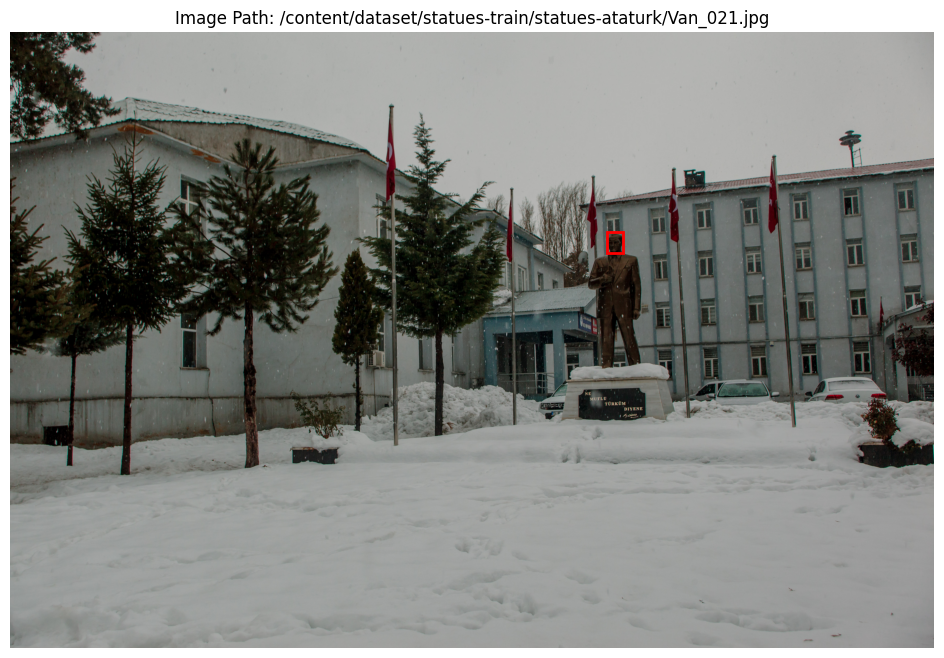

In [22]:
# Filter the row where class is '2'
suspicious_entries = labels_df_unified[labels_df_unified['class'] == '2']

# Display these entries
print(suspicious_entries)

display_images_with_boxes(suspicious_entries, 1)

Coordinates are correct and it's in the statues-ataturk dir. Plus given the fact ataturk class is less represented, let's fix that and add class 'ataturk'

In [23]:
labels_df_unified.loc[labels_df_unified['class'] == '2', 'class'] = 'ataturk'

In [24]:
labels_df_unified.to_csv("statues_labels_unified.csv")

# Verifications

In [25]:
import os

def count_images_in_directories(class_directories):
    sum_files = 0
    for class_name, directory in class_directories.items():
        image_files = [f for f in os.listdir(directory) if f.endswith(('.jpg', '.JPG', '.jpeg', '.JPEG', '.png', '.PNG'))]
        print(f"Total images in {class_name} folder: {len(image_files)}")
        sum_files += len(image_files)
    print(f"Total images: {sum_files}")

count_images_in_directories(class_directories)


Total images in lenin folder: 379
Total images in ataturk folder: 117
Total images in other folder: 353
Total images: 849


In [26]:
import pandas as pd

def count_unique_filenames_labels(df):
    df['filename'].unique()
    unique_filenames = df['filename'].unique()
    print(f"Total unique image filenames in CSVs: {len(unique_filenames)}")
    return unique_filenames

unique_filenames_labels = count_unique_filenames_labels(labels_df_unified)

Total unique image filenames in CSVs: 782


In [27]:
def find_images_without_labels(class_directories, unique_filenames_in_csv):
    missing_in_csv = []
    for class_name, directory in class_directories.items():
        image_files = [f for f in os.listdir(directory) if f.endswith(('.jpg', '.JPG', '.jpeg', '.JPEG', '.png', '.PNG'))]
        for image_file in image_files:
            if image_file not in unique_filenames_in_csv:
                full_path = os.path.join(directory, image_file)
                missing_in_csv.append(full_path)
    if missing_in_csv:
        print(f"{len(missing_in_csv)} images without CSV labels found.")
    else:
        print("No images without CSV labels found.")
    return missing_in_csv

images_without_labels = find_images_without_labels(class_directories, unique_filenames_labels)

65 images without CSV labels found.


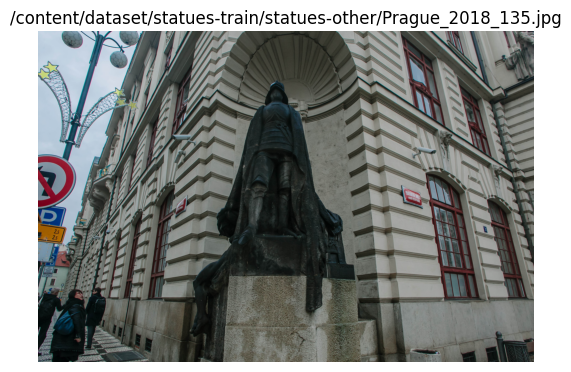

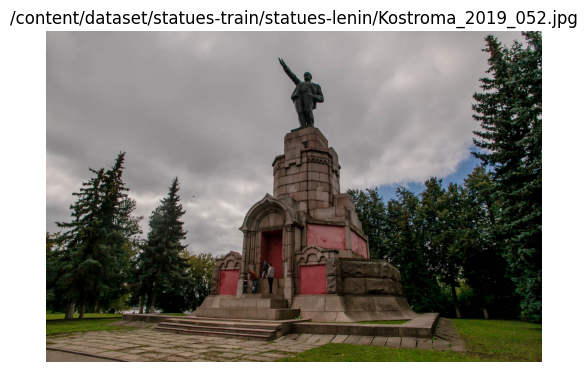

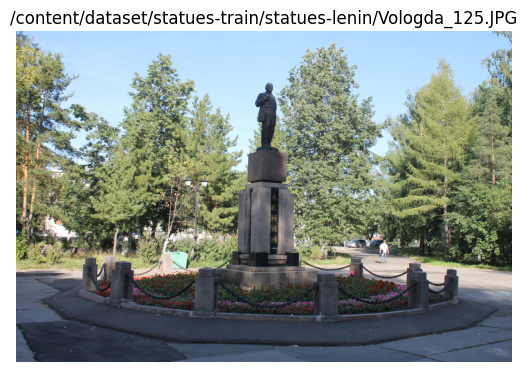

In [28]:
import random
from PIL import Image
import matplotlib.pyplot as plt

def plot_random_images(image_paths, n=5):
    selected_images = random.sample(image_paths, min(len(image_paths), n))
    for image_path in selected_images:
        img = Image.open(image_path)
        plt.imshow(img)
        plt.title(image_path)
        plt.axis('off')
        plt.show()

# Plot n random images without CSV labels
plot_random_images(images_without_labels, n=3)

Images without labels seem to be of statues where the head either hard to see or really small. Since we have no labels for these they won't be included in the dataset for training as the inconsistency would hinder the training and the model. And also there are no resources (time) for labelling these.


In [29]:
from collections import defaultdict

def check_repeated_filenames(class_directories):
    # Dictionary to store filenames and their corresponding directories
    filename_directory_mapping = defaultdict(list)

    # Gather filenames and their directories
    for class_name, directory in class_directories.items():
        image_files = [f for f in os.listdir(directory) if f.endswith(('.jpg', '.JPG', '.jpeg', '.JPEG', '.png', '.PNG'))]
        for image_file in image_files:
            filename_directory_mapping[image_file].append(directory)

    # Check for repeated filenames in different directories
    repeated_filenames = {filename: dirs for filename, dirs in filename_directory_mapping.items() if len(dirs) > 1}

    if repeated_filenames:
        print("Repeated filenames found in different folders:")
        for filename, dirs in repeated_filenames.items():
            print(f"Filename: {filename}, Folders: {dirs}")
    else:
        print("No repeated filenames in different folders.")


check_repeated_filenames(class_directories)

Repeated filenames found in different folders:
Filename: Moscow_2017_1408.jpg, Folders: ['/content/dataset/statues-train/statues-lenin', '/content/dataset/statues-train/statues-other']
Filename: Ulyanovsk_069.JPG, Folders: ['/content/dataset/statues-train/statues-lenin', '/content/dataset/statues-train/statues-other']


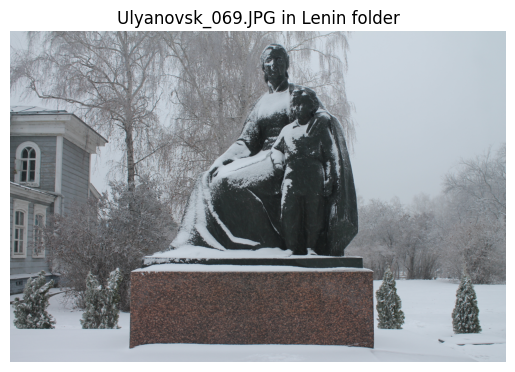

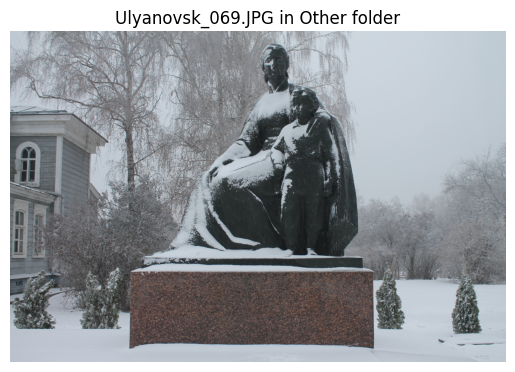

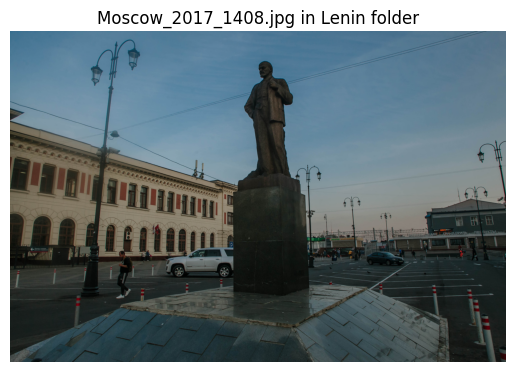

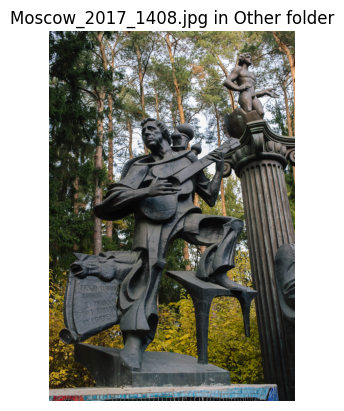

In [30]:
from PIL import Image
import matplotlib.pyplot as plt

def plot_image(image_path, title):
    # Load the image
    image = Image.open(image_path)

    # Plot the image
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')
    plt.show()

# Define the image paths based on the folders listed
image_paths = [
    ('/content/dataset/statues-train/statues-lenin/Ulyanovsk_069.JPG', 'Ulyanovsk_069.JPG in Lenin folder'),
    ('/content/dataset/statues-train/statues-other/Ulyanovsk_069.JPG', 'Ulyanovsk_069.JPG in Other folder'),
    ('/content/dataset/statues-train/statues-lenin/Moscow_2017_1408.jpg', 'Moscow_2017_1408.jpg in Lenin folder'),
    ('/content/dataset/statues-train/statues-other/Moscow_2017_1408.jpg', 'Moscow_2017_1408.jpg in Other folder')
]

# Plot each image
for image_path, title in image_paths:
    plot_image(image_path, title)


In [31]:
import os

# Define the old and new filenames
old_filename = '/content/dataset/statues-train/statues-lenin/Moscow_2017_1408.jpg'
new_filename = '/content/dataset/statues-train/statues-lenin/Moscow_2017_1408_0.jpg'

# Rename the file
os.rename(old_filename, new_filename)

# Update the DataFrame
labels_df_unified.loc[(labels_df_unified['filename'] == 'Moscow_2017_1408.jpg') & (labels_df_unified['class'] == 'lenin'), 'filename'] = 'Moscow_2017_1408_0.jpg'


In [33]:
count_images_in_directories(class_directories)
unique_filenames_labels = count_unique_filenames_labels(labels_df_unified)
images_without_labels = find_images_without_labels(class_directories, unique_filenames_labels)
check_repeated_filenames(class_directories)

Total images in lenin folder: 379
Total images in ataturk folder: 117
Total images in other folder: 353
Total images: 849
Total unique image filenames in CSVs: 783
65 images without CSV labels found.
Repeated filenames found in different folders:
Filename: Ulyanovsk_069.JPG, Folders: ['/content/dataset/statues-train/statues-lenin', '/content/dataset/statues-train/statues-other']


```
  849 total images in all directories
- 783 different filenames
- 65 images without CSV label
- 1 repeated image
= 0
```

Verification checked!


# Process dataset (YOLO format)

In [34]:
from tqdm import tqdm
from sklearn.model_selection import train_test_split
import pandas as pd
import os
from PIL import Image


output_base = '/content/statues-dataset-processed'  # Directory where train/val/test folders will be created
seed = 22
split_ratio = (0.9, 0.05, 0.05)  # Split ratio for train/val/test

# Create directories for images and labels
for file_type in ['images', 'labels']:
    for split_name in ['train', 'val', 'test']:
        os.makedirs(os.path.join(output_base, file_type, split_name), exist_ok=True)

# Split based on unique filenames to ensure all labels for a given image go to the same set
unique_filenames = labels_df_unified['filename'].unique()
train_filenames, test_filenames = train_test_split(unique_filenames, test_size=split_ratio[2], random_state=seed)
train_filenames, val_filenames = train_test_split(train_filenames, test_size=split_ratio[1]/(split_ratio[0]+split_ratio[1]), random_state=seed)


def find_image_path(filename, preferred_class=None):
    # If a preferred class is specified, check its directory first
    if preferred_class and preferred_class in class_directories:
        preferred_path = os.path.join(class_directories[preferred_class], filename)
        if os.path.isfile(preferred_path):
            return preferred_path

    # Check other directories
    for class_name, directory in class_directories.items():
        potential_path = os.path.join(directory, filename)
        if os.path.isfile(potential_path):
            return potential_path

    return None  # Return None if the file is not found in any directory


# Function to process data
def process_data(filenames, split_name):
    for filename in tqdm(filenames):
        image_labels = labels_df_unified[labels_df_unified['filename'] == filename]
        first_row = image_labels.iloc[0]
        preferred_class = first_row['class']
        rotated = first_row['rotated']

        src_img_path = find_image_path(filename, preferred_class)

        # Skip if the source image is not found
        if not src_img_path:
            print(f"{filename} not found")
            continue

        # Load and potentially rotate image only once
        img = Image.open(src_img_path)
        if rotated:
            img = img.rotate(-90, expand=True)  # Rotate 90 degrees counter-clockwise

        dst_img_path = os.path.join(output_base, 'images', split_name, filename)

        # Get image dimensions
        img_width, img_height = img.size

        # Save image to respective directory only once
        if not os.path.exists(dst_img_path):
            img.save(dst_img_path)

        labels_list = []  # List to store labels for this image
        for index, row in image_labels.iterrows():
            # Create label in YOLO format and add to the list
            x_center = (row['xmin'] + row['xmax']) / 2 / img_width
            y_center = (row['ymin'] + row['ymax']) / 2 / img_height
            width = (row['xmax'] - row['xmin']) / img_width
            height = (row['ymax'] - row['ymin']) / img_height
            class_id = 1 if row['class'] == 'lenin' else 2 if row['class'] == 'ataturk' else 0
            label = f"{class_id} {x_center} {y_center} {width} {height}\n"
            labels_list.append(label)

        # Save labels as a .txt file
        base_filename, _ = os.path.splitext(filename)  # Separate base filename and extension
        label_file = base_filename + '.txt'  # Change file extension to .txt
        label_path = os.path.join(output_base, 'labels', split_name, label_file)
        with open(label_path, 'w') as f:
            f.writelines(labels_list)


# Process each set
process_data(train_filenames, 'train')
process_data(val_filenames, 'val')
process_data(test_filenames, 'test')

100%|██████████| 40/40 [00:05<00:00,  7.25it/s]


Export to ZIP file and move to Drive

In [35]:
import shutil
import os

def zip_directory(folder_path, output_filename):
    # Create a zip file (with the specified output filename) containing the contents of the folder
    shutil.make_archive(output_filename, 'zip', folder_path)
    print(f"Directory {folder_path} has been zipped as {output_filename}.zip")

output_filename = 'statues-dataset-processed'
zip_directory(output_base, output_filename)


Directory /content/statues-dataset-processed has been zipped as statues-dataset-processed.zip


In [36]:
import shutil

def move_file(src, dst):
    # Move the file from src to dst
    shutil.move(src, dst)
    print(f"File {src} has been moved to {dst}")

move_file(f"{output_filename}.zip", toptal_drive_dir)

File statues-dataset-processed.zip has been moved to /content/drive/My Drive/Toptal


## Dataset processing verification (YOLO format)

In [37]:
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import os
import random

class_id_to_label = {0: 'other', 1: 'lenin', 2: 'ataturk'}

def plot_image_with_labels(image_path, labels):
    plt.figure(figsize=(7, 7))
    img = Image.open(image_path)
    plt.imshow(img)
    img_width, img_height = img.size

    for label in labels:
        class_id, x_center, y_center, width, height = map(float, label.split())
        box_width = width * img_width
        box_height = height * img_height
        x_left = (x_center * img_width) - (box_width / 2)
        y_top = (y_center * img_height) - (box_height / 2)

        rect = patches.Rectangle((x_left, y_top), box_width, box_height, linewidth=1, edgecolor='r', facecolor='none')
        plt.gca().add_patch(rect)

        # Add class label text above the rectangle
        label_text = class_id_to_label.get(class_id, 'Unknown')
        plt.text(x_left, y_top, label_text, color='white', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))

    plt.title(f'Image: {os.path.basename(image_path)}')
    plt.axis('off')
    plt.show()

def plot_random_images_with_labels(split_name, n):
    image_files = os.listdir(os.path.join(output_base, 'images', split_name))
    selected_images = random.sample(image_files, n)

    for image_file in selected_images:
        base_filename, _ = os.path.splitext(image_file)
        label_file = base_filename + '.txt'
        label_path = os.path.join(output_base, 'labels', split_name, label_file)

        with open(label_path, 'r') as file:
            labels = file.readlines()

        plot_image_with_labels(os.path.join(output_base, 'images', split_name, image_file), labels)


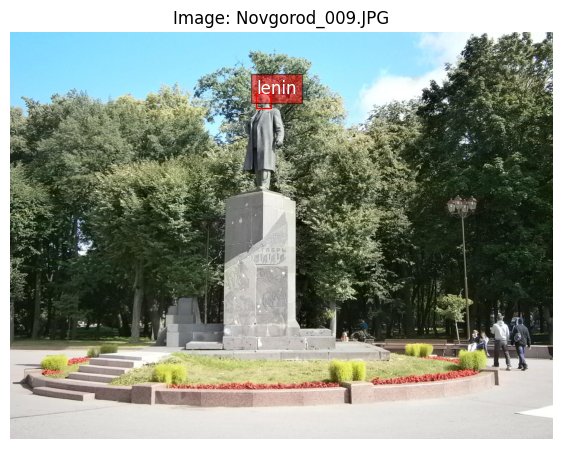

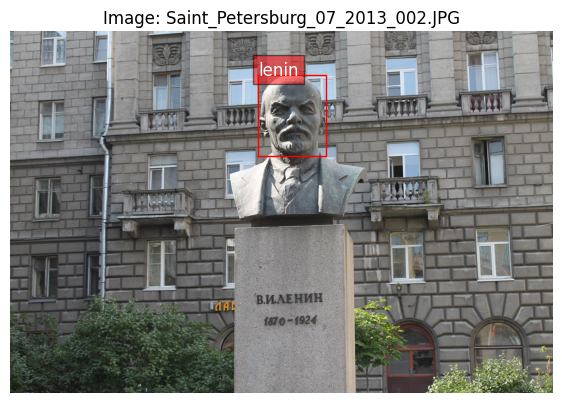

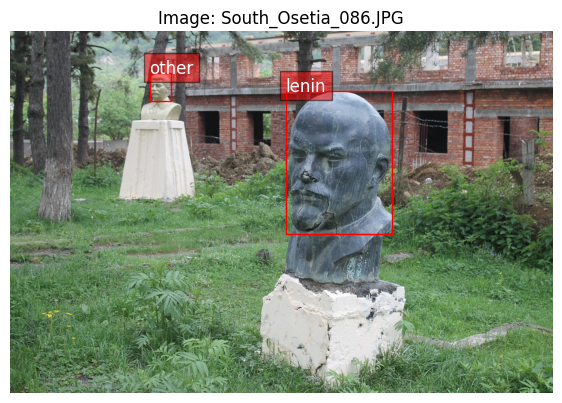

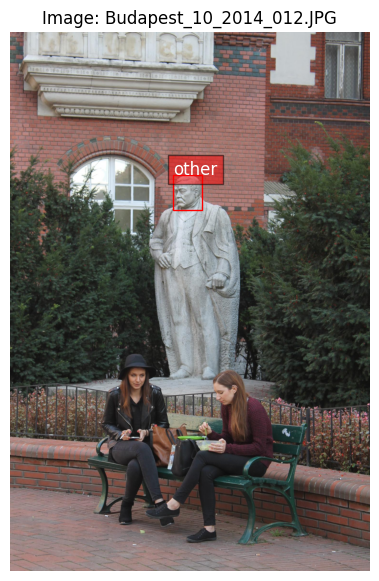

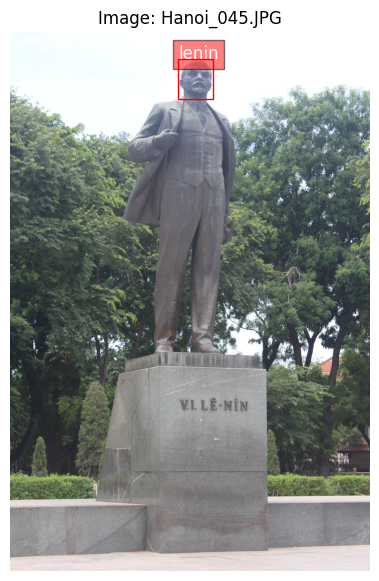

In [38]:
plot_random_images_with_labels('train', 5)

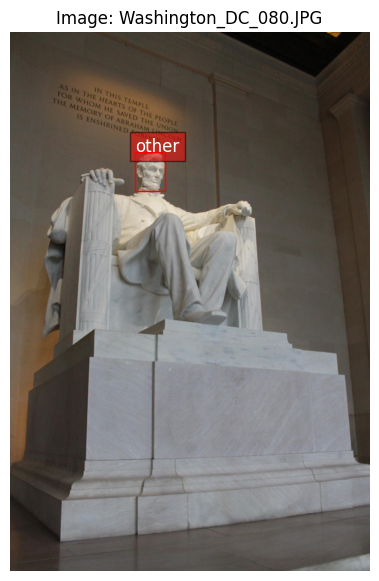

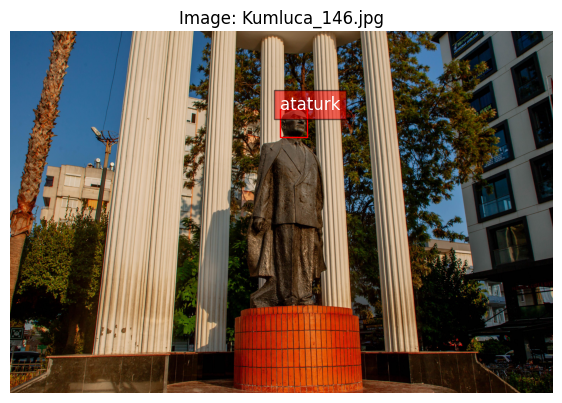

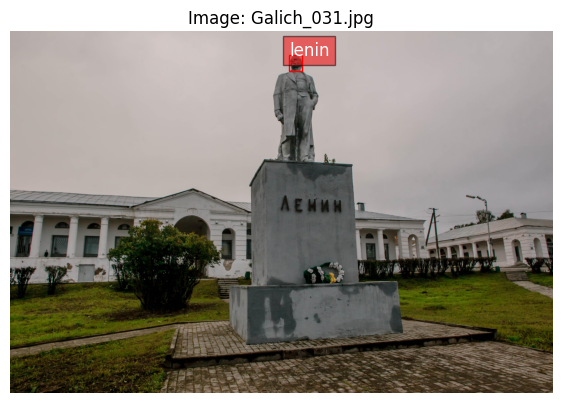

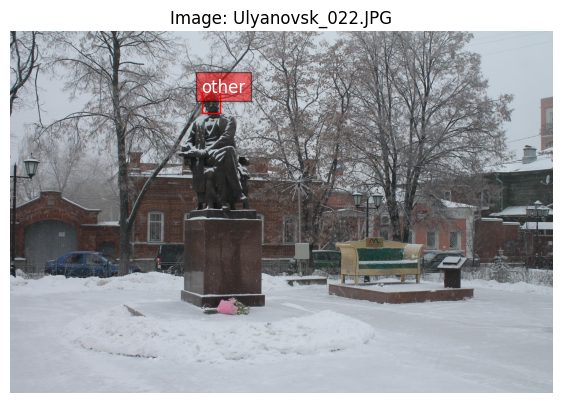

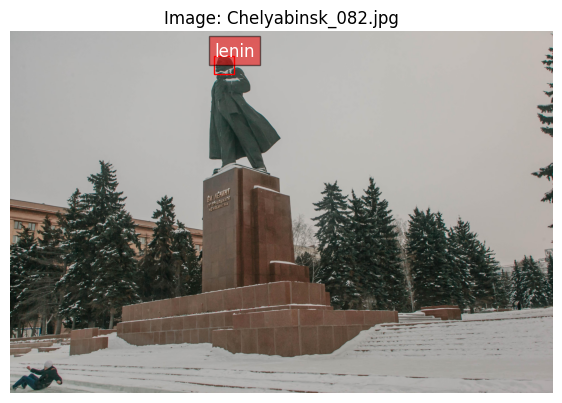

In [39]:
plot_random_images_with_labels('val', 5)

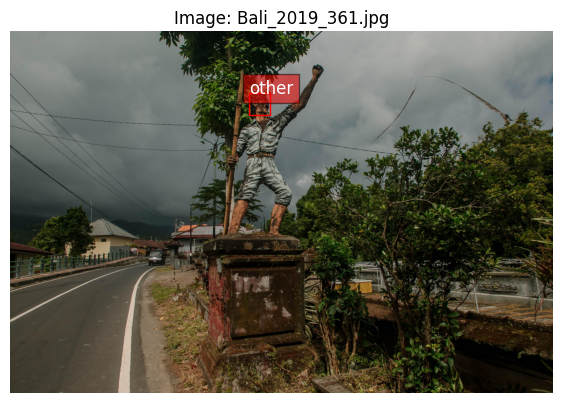

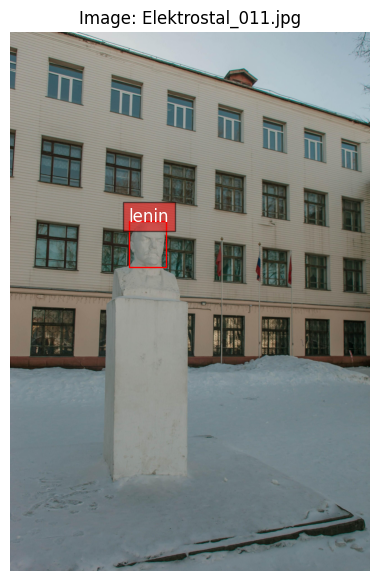

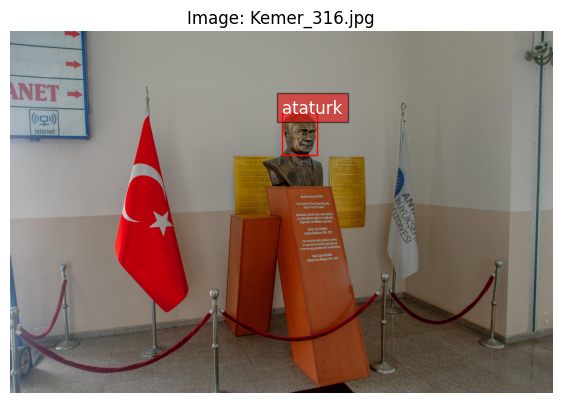

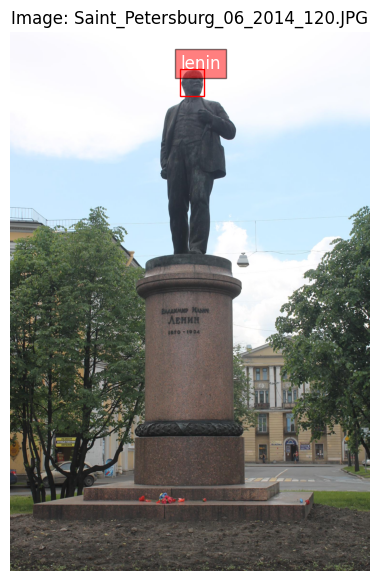

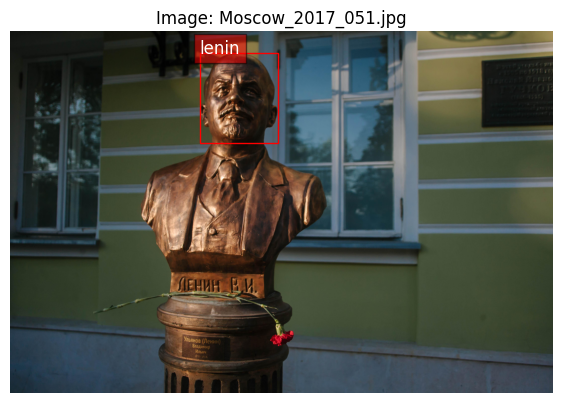

In [40]:
plot_random_images_with_labels('test', 5)

Labels look good! Even on those images where many heads are present.